## Load data

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load the data
sinogram = np.load('sinogram.npy')
sinogram.shape

(512, 180)

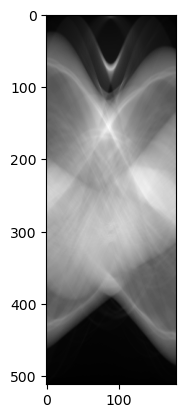

In [3]:
plt.imshow(sinogram, cmap='gray')

In [4]:
sinogram = sinogram.T
sinogram.shape

(180, 512)

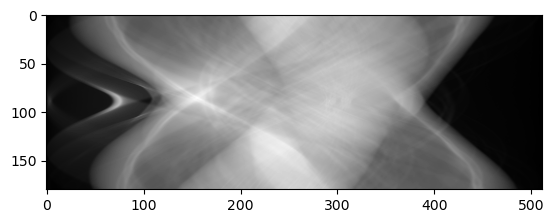

In [5]:
plt.imshow(sinogram, cmap='gray')

In [379]:
sinogram[0]

array([  1337.3376203 ,   2999.80624961,   3894.02907581,   4277.60908898,
         4661.74547128,   5059.57299741,   6522.15961319,   7036.287748  ,
         7642.65604184,   8240.0674216 ,   8185.020721  ,   7384.59797799,
         6491.20845066,   6099.63676693,   6370.18950283,   7160.54672272,
         8042.14611636,   9665.93185306,  10669.0697602 ,  10968.66644344,
        11240.32575277,  11814.23900682,  12535.34445016,  14301.98439704,
        19319.0555028 ,  28723.98705598,  40916.10929886,  51840.96670886,
        59779.3886844 ,  66234.00682084,  72355.97749964,  78365.09575346,
        84406.68640842,  90060.04135629,  94890.64254756,  98932.36494792,
       102548.27944785, 106129.22507626, 110180.29905052, 113830.9907294 ,
       117230.33777137, 120965.85043894, 124372.2710827 , 127483.39975542,
       130205.40023688, 132831.96100404, 135473.06999912, 137810.72232539,
       140678.15124782, 144065.92531781, 147396.69871948, 151430.00533602,
       155413.40090947, 1

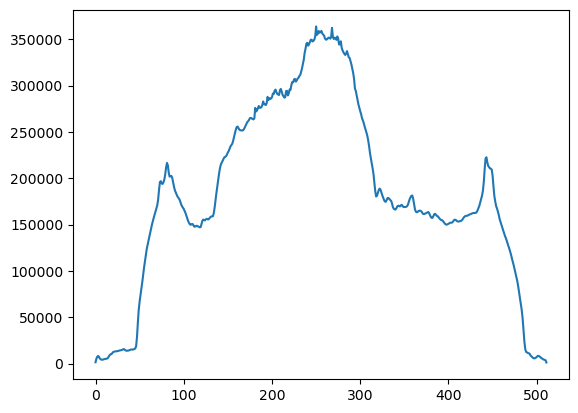

In [668]:
th = 179
plt.plot(sinogram[th])

## Back projection

In [40]:
from scipy.ndimage import rotate

imgs = []
for i in range(sinogram.shape[0]):
    img = []
    for j in range(sinogram.shape[1]):
        img.append(sinogram[i])
    img = rotate(img, i+1, reshape=False)
    imgs.append(np.array(img))
imgs = np.array(imgs)
imgs.shape

(180, 512, 512)

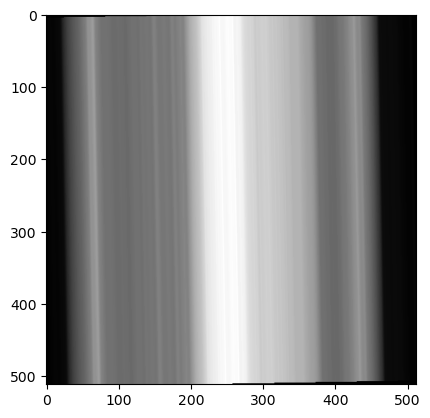

In [41]:
plt.imshow(imgs[0], cmap='gray')

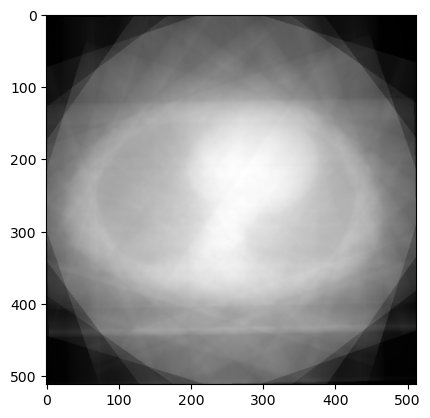

In [175]:
# 10 imgs sum
imgs_sum_10 = imgs[::18].sum(axis=0)
plt.imshow(imgs_sum_10, cmap='gray')

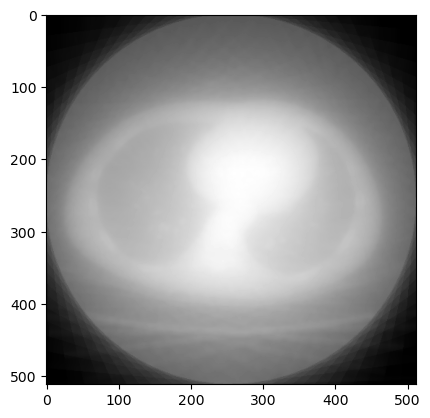

In [181]:
# 30 imgs sum
imgs_sum_30 = imgs[::6].sum(axis=0)
plt.imshow(imgs_sum_30, cmap='gray')

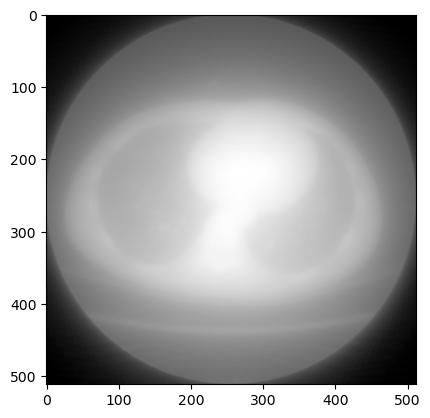

In [182]:
# 60 imgs sum
imgs_sum_60 = imgs[::3].sum(axis=0)
plt.imshow(imgs_sum_60, cmap='gray')    

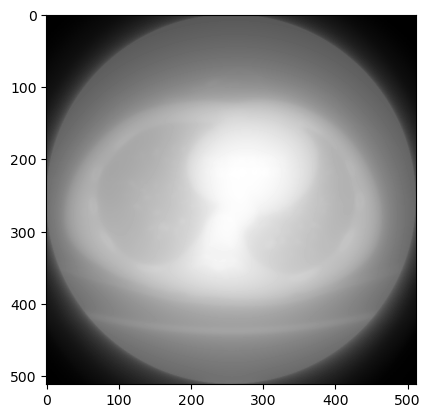

In [183]:
# 180 imgs sum
imgs_sum = imgs.sum(axis=0)
imgs_sum.shape
plt.imshow(imgs_sum, cmap='gray')

## Filtered Back projection

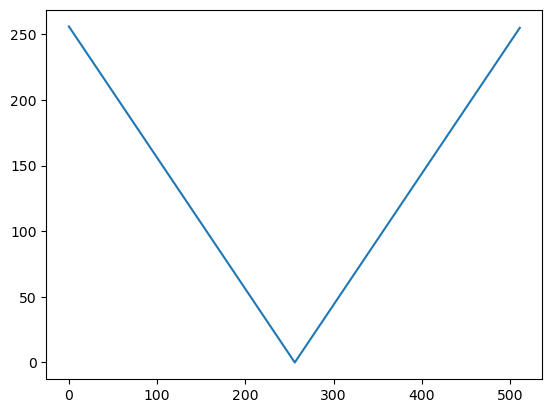

In [203]:
abs_w = []
for i in range(-256, 256):
    abs_w.append(np.abs(i))
abs_w = np.array(abs_w) 
plt.plot(abs_w)

In [189]:
from scipy.fft import fft ,fftshift, ifft, ifft2

fft_sinogram = fft(sinogram, axis=1)
fftshift_sinogram = fftshift(fft_sinogram, axes=(1,))
fftshift_sinogram.shape

(180, 512)

/Users/hanbeobmun/micromamba/envs/tensorflow/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


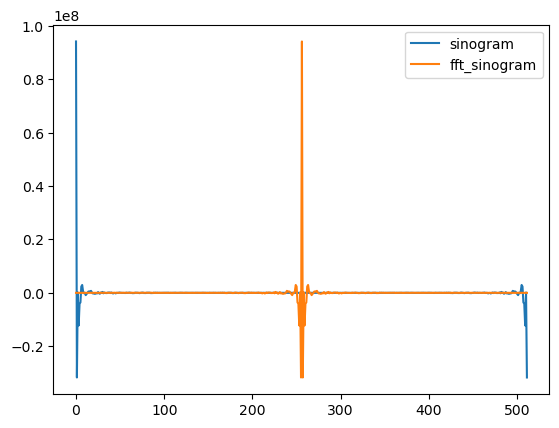

In [190]:
plt.plot(fft_sinogram[0])
plt.plot(fftshift_sinogram[0])
plt.legend(['sinogram', 'fft_sinogram'])
plt.show()

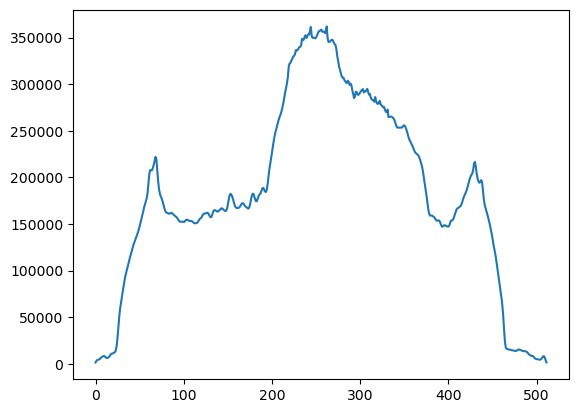

In [191]:
ifft_sinogram = ifft(fftshift_sinogram, axis=1)
plt.plot(np.abs(ifft_sinogram[0]))

In [192]:
abs_w_fft_sinogram = []
for th in range(fftshift_sinogram.shape[0]):
    abs_w_fft_sinogram.append(fftshift_sinogram[th]*abs_w)
abs_w_fft_sinogram = np.array(abs_w_fft_sinogram)
abs_w_fft_sinogram.shape

(180, 512)

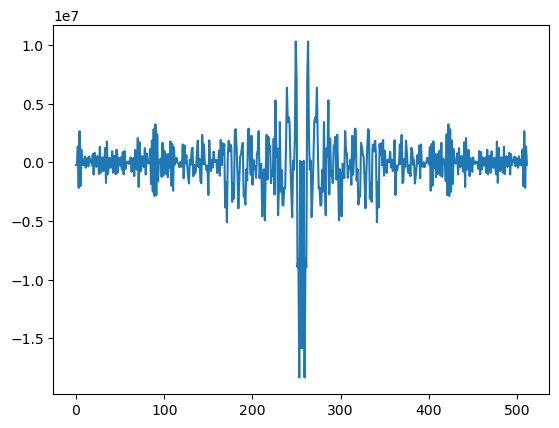

In [193]:
plt.plot(abs_w_fft_sinogram[0])

In [194]:
abs_w_ifft_sinogram = ifft(abs_w_fft_sinogram, axis=1)

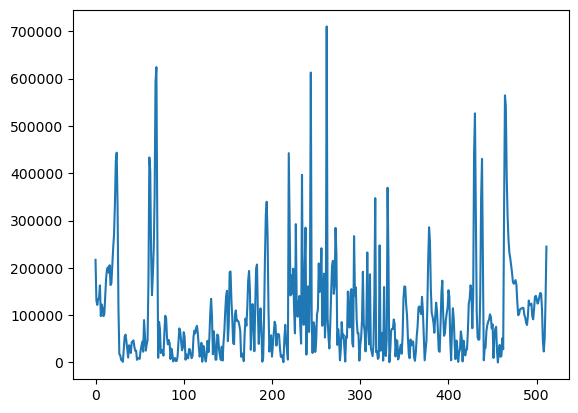

In [195]:
plt.plot(np.abs(abs_w_ifft_sinogram[0]))

In [196]:
conv_imgs = []
for i in range(abs_w_ifft_sinogram.shape[0]):
    img = []
    for j in range(abs_w_ifft_sinogram.shape[1]):
        img.append(np.abs(abs_w_ifft_sinogram[i]))
    img = rotate(img, i+1, reshape=False)
    conv_imgs.append(np.array(img))
conv_imgs = np.array(conv_imgs)
conv_imgs.shape

(180, 512, 512)

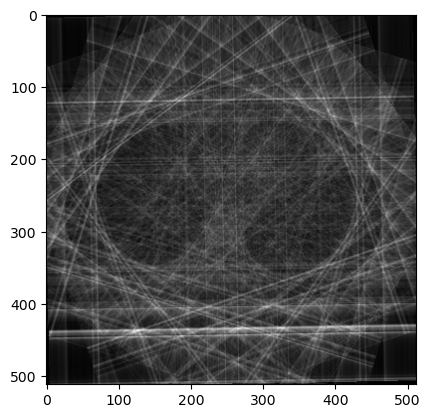

In [197]:
# 10 imgs sum
conv_imgs_sum_10 = conv_imgs[::18].sum(axis=0)
plt.imshow(conv_imgs_sum_10, cmap='gray')

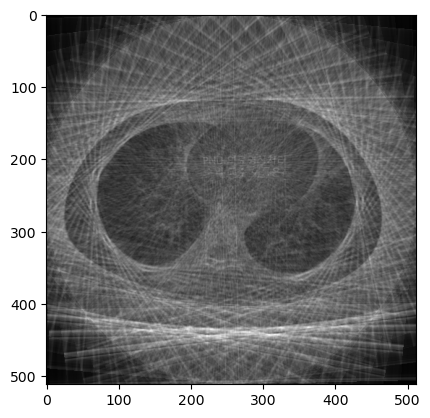

In [198]:
# 30 imgs sum
conv_imgs_sum_30 = conv_imgs[::6].sum(axis=0)
plt.imshow(conv_imgs_sum_30, cmap='gray')

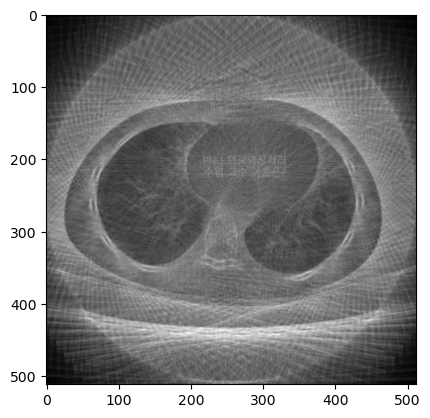

In [199]:
# 60 imgs sum
conv_imgs_sum_60 = conv_imgs[::3].sum(axis=0)
plt.imshow(conv_imgs_sum_60, cmap='gray')

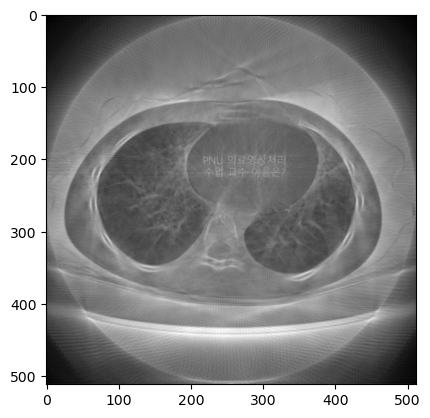

In [205]:
# 180 imgs sum
conv_imgs_sum = conv_imgs.sum(axis=0)
plt.imshow(conv_imgs_sum, cmap='gray')


In [201]:
dynamic_db = 12
conv_imgs_sum_db = 20*np.log10(conv_imgs_sum)
conv_imgs_sum_db = conv_imgs_sum_db - np.max(conv_imgs_sum_db)
conv_imgs_sum_db = np.maximum(conv_imgs_sum_db, -dynamic_db)

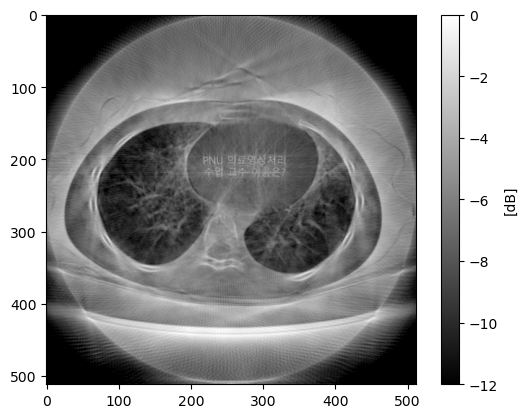

In [202]:
plt.imshow(conv_imgs_sum_db, cmap='gray')
plt.colorbar(label='[dB]')

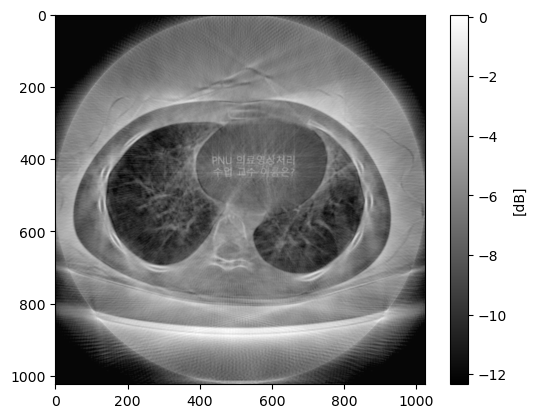

In [213]:
import scipy

scan_conversion_img = scipy.ndimage.zoom(conv_imgs_sum_db, (2, 2))
plt.imshow(scan_conversion_img, cmap='gray')
plt.colorbar(label='[dB]')

# 실패

In [698]:

sinogram_fft = fft(sinogram, axis=1)
sinogram_fft_shift = fftshift(sinogram_fft, axes=(1,))

In [616]:
sinogram_fft.shape

(180, 512)

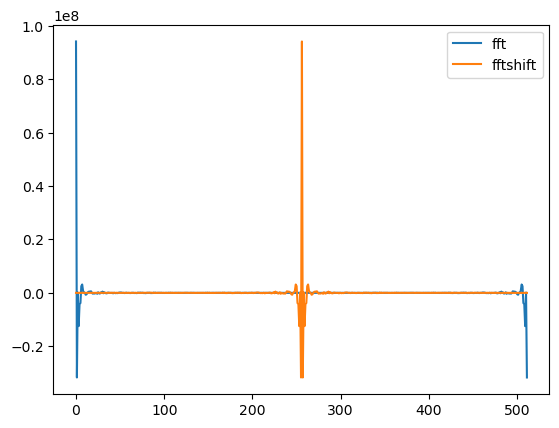

In [699]:
plt.plot(sinogram_fft[th])
plt.plot(sinogram_fft_shift[th])
plt.legend(['fft', 'fftshift'])

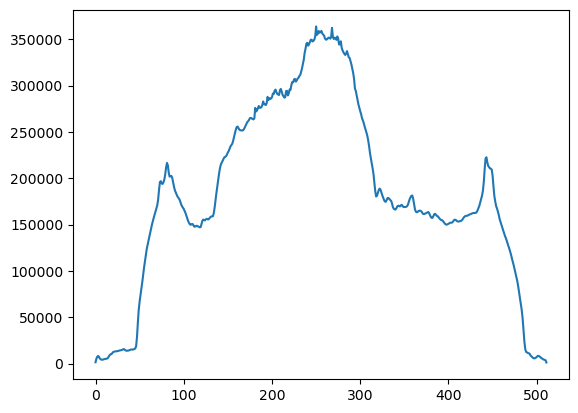

In [710]:
sinogram_ifft = ifft(sinogram_fft_shift, axis=1)
plt.plot(np.abs(sinogram_ifft[th]))

In [619]:
sinogram_fft_shift.shape

(180, 512)

In [649]:
# theta <= 90
# cos -> col(x==u)
# sin -> row(y==v)
# theta > 90
# sin -> col(x==u)
# cos -> row(y==v)

cos_th = dict()
sin_th = dict()
for th in range(1, 181):
    theta = np.deg2rad(th)
    w_cos = []
    w_sin = []
    for w in range(-256, 256):
        if theta <= np.pi/2:
            w_cos.append(w*np.cos(theta))
            w_sin.append(w*np.sin(theta))
        else:
            w_cos.append(w*np.cos(theta-np.pi/2))
            w_sin.append(-w*np.sin(theta-np.pi/2))
    cos_th[th] = np.array(w_cos)
    sin_th[th] = np.array(w_sin)

In [650]:
cos_th[1]

array([-255.96100996, -254.96116226, -253.96131457, -252.96146687,
       -251.96161918, -250.96177148, -249.96192379, -248.96207609,
       -247.9622284 , -246.9623807 , -245.96253301, -244.96268531,
       -243.96283762, -242.96298992, -241.96314223, -240.96329453,
       -239.96344684, -238.96359914, -237.96375145, -236.96390375,
       -235.96405606, -234.96420836, -233.96436067, -232.96451297,
       -231.96466528, -230.96481758, -229.96496989, -228.96512219,
       -227.9652745 , -226.9654268 , -225.96557911, -224.96573141,
       -223.96588372, -222.96603602, -221.96618832, -220.96634063,
       -219.96649293, -218.96664524, -217.96679754, -216.96694985,
       -215.96710215, -214.96725446, -213.96740676, -212.96755907,
       -211.96771137, -210.96786368, -209.96801598, -208.96816829,
       -207.96832059, -206.9684729 , -205.9686252 , -204.96877751,
       -203.96892981, -202.96908212, -201.96923442, -200.96938673,
       -199.96953903, -198.96969134, -197.96984364, -196.96999

In [652]:
def cal_uv_val(w, th, val):
    if th <= 90:
        u = cos_th[th][w]
        v = sin_th[th][w]
    else:
        u = sin_th[th][w]
        v = cos_th[th][w]
    u1, u2 = int(np.floor(u)), int(np.ceil(u))
    v1, v2 = int(np.floor(v)), int(np.ceil(v))
    if u1 == u2:
        u1_w, u2_w = 1, 0
    else:
        if u < 0:
            u1_w, u2_w = u2 - u, u - u1
        else:
            u1_w, u2_w = u - u1, u2 - u
    if v1 == v2:
        v1_w, v2_w = 1, 0
    else:
        if v < 0:
            v1_w, v2_w = v2 - v, v - v1
        else:
            v1_w, v2_w = v - v1, v2 - v
    
    u1, u2, v1, v2 = u1+300, u2+300, v1+300, v2+300
    u1_val = u1_w * val
    u2_val = u2_w * val
    v1u1_val = v1_w * u1_val
    v1u2_val = v1_w * u2_val
    v2u1_val = v2_w * u1_val
    v2u2_val = v2_w * u2_val
    coord = dict({'v1': v1, 'v2': v2, 'u1': u1, 'u2': u2})
    vals = dict({'v1u1': v1u1_val, 'v1u2': v1u2_val, 'v2u1': v2u1_val, 'v2u2': v2u2_val})
    return (coord, vals)

In [614]:
cal_uv_val(0, 180, 1)

({'v1': 299, 'v2': 300, 'u1': 556, 'u2': 556},
 {'v1u1': 1.567547902908612e-14,
  'v1u2': 0.0,
  'v2u1': 0.9999999999999843,
  'v2u2': 0.0})

In [711]:
f_uv = np.zeros([180, 600, 600])

for th in range(1, 181):
    for w in range(sinogram_fft_shift.shape[1]):
        coord, vals = cal_uv_val(w, th, sinogram_fft_shift[th-1][w])
        # print(th, w, coord, vals)
        # f_uv[coord['v1']][coord['u1']] += np.abs(vals['v1u1'])
        # f_uv[coord['v1']][coord['u2']] += np.abs(vals['v1u2'])
        # f_uv[coord['v2']][coord['u1']] += np.abs(vals['v2u1'])
        # f_uv[coord['v2']][coord['u2']] += np.abs(vals['v2u2'])
        f_uv[th-1][coord['v1']][coord['u1']] += vals['v1u1']
        f_uv[th-1][coord['v1']][coord['u2']] += vals['v1u2']
        f_uv[th-1][coord['v2']][coord['u1']] += vals['v2u1']
        f_uv[th-1][coord['v2']][coord['u2']] += vals['v2u2']


/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/2393707758.py:11: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[th-1][coord['v1']][coord['u1']] += vals['v1u1']
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/2393707758.py:12: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[th-1][coord['v1']][coord['u2']] += vals['v1u2']
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/2393707758.py:13: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[th-1][coord['v2']][coord['u1']] += vals['v2u1']
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/2393707758.py:14: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[th-1][coord['v2']][coord['u2']] += vals['v2u2']


array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [654]:
crop_f_uv = f_uv[300-256:300+256, 300-256:300+256]
crop_f_uv.shape

(512, 512)

In [484]:
def cal_uv_val(w, theta, val):
    if theta <= np.deg2rad(90):
        u = w * np.cos(theta)
        v = w * np.sin(theta)
    else:
        u = -(w * np.cos(theta - np.pi/2))
        v = w * np.sin(theta - np.pi/2)
    # if theta >= np.deg2rad(175):
    #     u -= 1
    #     v -= 1
    u1, u2 = int(np.floor(u)), int(np.ceil(u))
    v1, v2 = int(np.floor(v)), int(np.ceil(v))
    # if theta < np.deg2rad(175):
    # else:
    #     u1, u2 = u1+255, u2+255
    # v1, v2 = v1+256, v2+256
    if u1 == u2:
        u1_w, u2_w = 1, 0
    else:
        if u < 0:
            u1_w, u2_w = u2 - u, u - u1
        else:
            u1_w, u2_w = u - u1, u2 - u
    if v1 == v2:
        v1_w, v2_w = 1, 0
    else:
        if v < 0:
            v1_w, v2_w = v2 - v, v - v1
        else:
            v1_w, v2_w = v - v1, v2 - v
            
    u1, u2 = u1+256, u2+256

    u1_val = u1_w * val
    u2_val = u2_w * val
    v1u1_val = v1_w * u1_val
    v2u1_val = v2_w * u1_val
    v1u2_val = v1_w * u2_val
    v2u2_val = v2_w * u2_val
    print(f'u1: {u1}, u2: {u2}, v1: {v1}, v2: {v2}')
    print(f'u1_w: {u1_w}, u2_w: {u2_w}, v1_w: {v1_w}, v2_w: {v2_w}')
    print(f'v1u1_val: {v1u1_val}, v2u1_val: {v2u1_val}, v1u2_val: {v1u2_val}, v2u2_val: {v2u2_val}')
    coord = dict({'u1': u1, 'u2': u2, 'v1': v1, 'v2': v2})
    vals = dict({'v1u1_val': v1u1_val, 'v2u1_val': v2u1_val, 'v1u2_val': v1u2_val, 'v2u2_val': v2u2_val})
    return (coord, vals)

for i in range(sinogram_fft.shape[0]):
    theta = np.deg2rad(i+1)
    for w in range(sinogram_fft.shape[1]):
        # if theta < np.deg2rad(175):
        ww = w-256
        # else:
        #     ww = w-255
        coord, vals = cal_uv_val(ww, theta, sinogram_fft[i][w])
        # print(i+1, w, coord, vals)
        f_uv[coord['v1']][coord['u1']] += vals['v1u1_val']
        f_uv[coord['v1']][coord['u2']] += vals['v1u2_val']
        f_uv[coord['v2']][coord['u1']] += vals['v2u1_val']
        f_uv[coord['v2']][coord['u2']] += vals['v2u2_val']

u1: 0, u2: 1, v1: -5, v2: -4
u1_w: 0.961009960036165, u2_w: 0.03899003996383499, v1_w: 0.467816047944579, v2_w: 0.532183952055421
v1u1_val: (42354400.995515734+0j), v2u1_val: (48182042.082070515+0j), v1u2_val: (1718400.2831742815+0j), v2u2_val: (1954838.9969323645+0j)
u1: 1, u2: 2, v1: -5, v2: -4
u1_w: 0.9611622648797606, u2_w: 0.03883773512023936, v1_w: 0.4503636415072956, v2_w: 0.5496363584927044
v1u1_val: (-13732020.977077518+1181319.1520930016j), v2u1_val: (-16758941.683937091+1441714.8657937758j), v1u2_val: (-554870.5071562754+47733.626254244606j), v2u2_val: (-677179.4542909053+58255.44980546515j)
u1: 2, u2: 3, v1: -5, v2: -4
u1_w: 0.9613145697233847, u2_w: 0.03868543027661531, v1_w: 0.43291123507001217, v2_w: 0.5670887649299878
v1u1_val: (55854.116087330316-2639361.4338870132j), v2u1_val: (73165.67264210139-3457411.345549319j), v1u2_val: (2247.6935038861843-106213.75764106418j), v2u2_val: (2944.348932995081-139133.90034680683j)
u1: 3, u2: 4, v1: -5, v2: -4
u1_w: 0.961466874566980

/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/485513380.py:56: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[coord['v1']][coord['u1']] += vals['v1u1_val']
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/485513380.py:57: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[coord['v1']][coord['u2']] += vals['v1u2_val']
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/485513380.py:58: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[coord['v2']][coord['u1']] += vals['v2u1_val']
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/485513380.py:59: ComplexWarning: Casting complex values to real discards the imaginary part
  f_uv[coord['v2']][coord['u2']] += vals['v2u2_val']


u1: 421, u2: 422, v1: 84, v2: 85
u1_w: 0.7272134990364236, u2_w: 0.2727865009635764, v1_w: 0.4422329515557095, v2_w: 0.5577670484442905
v1u1_val: (-24010.195630714617+10510.317629679104j), v2u1_val: (-30282.89932354045+13256.15565709289j), v1u2_val: (-9006.512203406637+3942.5461353713827j), v2u2_val: (-11359.478552648674+4972.542895199708j)
u1: 422, u2: 423, v1: 84, v2: 85
u1_w: 0.6182200232248078, u2_w: 0.38177997677519215, v1_w: 0.8962234512952563, v2_w: 0.10377654870474373
v1u1_val: (-62449.325984815994-33570.31797103513j), v2u1_val: (-7231.2050195466445-3887.2133204279844j), v1u2_val: (-38565.39958014212-20731.252197984955j), v2u2_val: (-4465.6096223128425-2400.5372770877625j)
u1: 423, u2: 424, v1: 85, v2: 86
u1_w: 0.5092265474131636, u2_w: 0.49077345258683636, v1_w: 0.350213951034803, v2_w: 0.649786048965197
v1u1_val: (-3989.253352495862-10814.015489200061j), v2u1_val: (-7401.650238604723-20064.29606077415j), v1u2_val: (-3844.692801256331-10422.142649323012j), v2u2_val: (-7133.432

In [715]:
f_xy = ifft2(f_uv)
# f_xy = np.abs(ifft2(f_uv_shift))
# f_xy = np.abs(ifft(f_uv, axis=1))

In [726]:
f_xy_abs = np.abs(f_xy)
f_xy_abs_sum = f_xy_abs.sum(axis=0)
f_xy_abs_sum.shape

(600, 600)

In [728]:
log_f_xy_abs_sum =20 * np.log(f_xy_abs_sum)

/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/634389636.py:1: RuntimeWarning: divide by zero encountered in log
  plt.imshow(np.abs(20*np.log(f_uv[100])), cmap='gray')
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/634389636.py:1: RuntimeWarning: invalid value encountered in log
  plt.imshow(np.abs(20*np.log(f_uv[100])), cmap='gray')


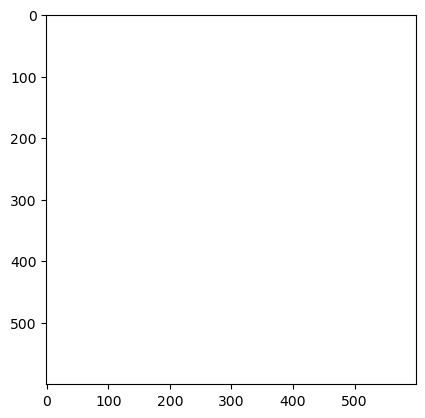

In [612]:
f_uv_db = 20 * np.log(crop_f_uv)
f_xy_db = 20 * np.log(f_xy)

/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/1842455764.py:1: RuntimeWarning: divide by zero encountered in log
  f_uv_db = 20 * np.log(crop_f_uv)
/var/folders/0d/kqhrwk7d217cmvzdwp23g7dh0000gn/T/ipykernel_13824/1842455764.py:1: RuntimeWarning: invalid value encountered in log
  f_uv_db = 20 * np.log(crop_f_uv)


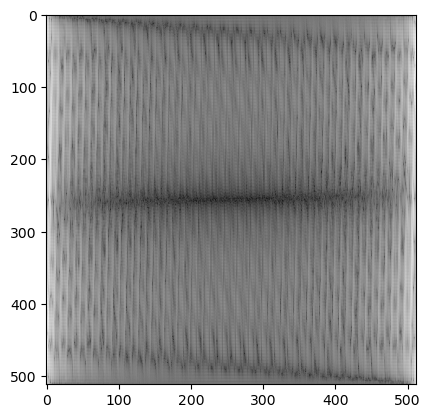

In [716]:
plt.imshow(np.abs(f_xy_db), cmap='gray')